# Mod 10.3.3 Scrape Mars Data: The News

In [1]:
# Import Splinter and BeautifulSoup

from splinter import Browser

from bs4 import BeautifulSoup as soup

from webdriver_manager.chrome import ChromeDriverManager

import pandas as pd

In [2]:
# Set the executable path

executable_path = {'executable_path': ChromeDriverManager().install()}

browser = Browser('chrome', **executable_path, headless=False)

In [3]:
# Visit the mars nasa news site
url = 'https://mars.nasa.gov/news'
browser.visit(url)
# Optional delay for loading the page
browser.is_element_present_by_css('div.list_text', wait_time=1)

# With the following line, browser.is_element_present_by_css('div.list_text', wait_time=1), we are accomplishing
# two things.

# One is that we're searching for elements with a specific combination of tag (div) and attribute (list_text).
# As an example, ul.item_list  would be found in HTML as <ul class='item_list'>.

# Second, we're also telling our browser to wait one second before searching for components. This optional delay
# is useful because sometimes dynamic pages take a little while to load, especially if they are image heavy.

True

In [4]:
# Set up the HTML parser:

html = browser.html

news_soup = soup(html, 'html.parser')

slide_elem = news_soup.select_one('div.list_text')

# Notice how we've assigned slide_elem as the variable to look for the <div /> tag and it descendents (the other tags
# within the <div /> element)? This is our parent element. This mean that this element hold all of the other element
# within it, and we'll reference it when we want to filter search results ever further. The . is used for selecting
# classes, such as list_text, so the code 'div.list_text' pinpoints the <div /> tag with the class of list_text.
# CSS works from right to left, such as returning the last item on the list instead of the first. Because of this,
# when using select_one, the first matching element returned will be a <li /> element with a class of slide and all nested
# elements within it.

# 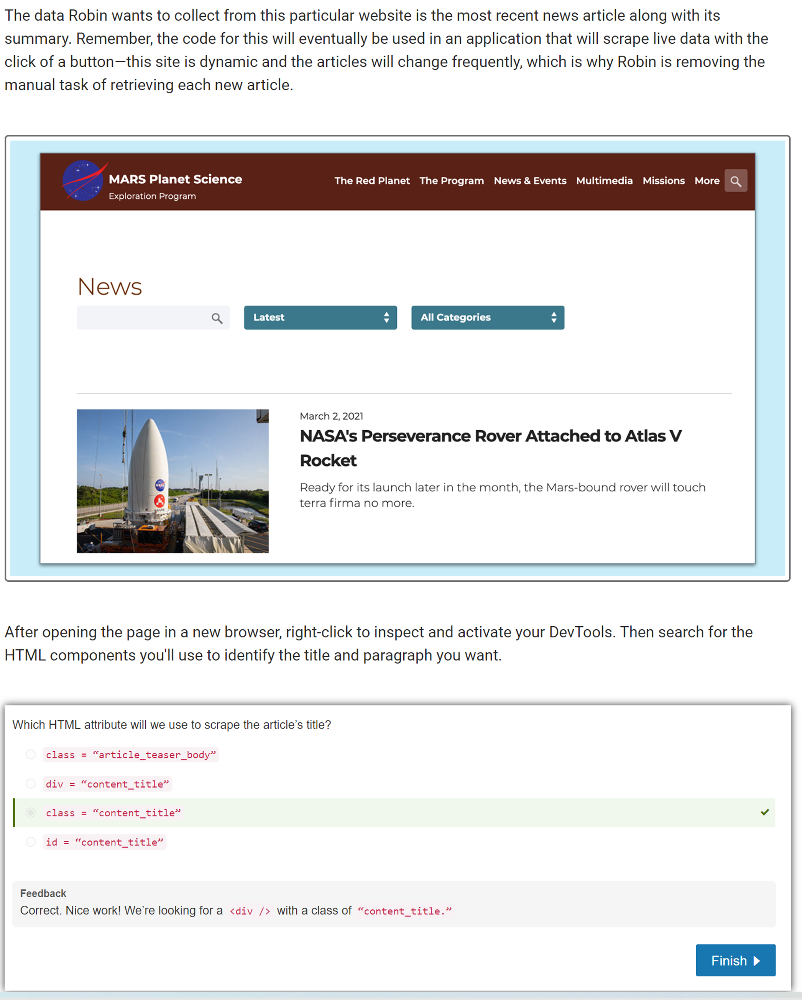

In [5]:
# We'll want to assign the title and summary text to variables we'll reference later. 

slide_elem.find('div', class_='content_title')


# in this line of code, we chained .find() onto our previously assigned variable, slide_elem. When we do this, we're
# saying, "This variable hold a ton of information, so look inside of the information to find this specific data."
# The data we're looking for is the content title, which we've specified by saying, "The specific data is in a <div />
# with a class of 'content_title'."

<div class="content_title"><a href="/news/9485/historic-wind-tunnel-facility-testing-nasas-mars-ascent-vehicle-rocket/" target="_self">Historic Wind Tunnel Facility Testing NASA's Mars Ascent Vehicle Rocket</a></div>

In [6]:
# The title is in that mix of HTML in our output. But we need to get just the text, and the extra HTML
# stuff isn't necessary.

# Use the parent element to find the first 'a' tag and save it as 'news_title'

news_title = slide_elem.find('div', class_='content_title').get_text()

news_title

# We've added something new to our .find() method here: .get_text(). When the new method is chained onto .find(),
# only the text of the element is returned. 

"Historic Wind Tunnel Facility Testing NASA's Mars Ascent Vehicle Rocket"

In [7]:
# Before we can update our code, we'll need to use our DevTools to make sure we're scraping the right tag and class.
# Use the DevTools selector and select the article summary (teaser), then check to see which tag is highlighted.

# We know that 'article_teaser_body' is the right class name, but when we search for it, there more than one result.
# That's okay. There will be many matches because there are many articles, each with a tag of <div /> and a
# class of article_teaser_boday. We want to pull the first one on the list, not a specific on, so more that 10 results is fine.
# In this case, if our scraping code is too specific, we'd pull only the article summary instead of the most recent.

# Because news article are added to the top of the list, and we only need the most recent one, our search leads us to 
# the first article.

# IMPORTANT:

# There are two methods to find tags and attributes with BeautifulSoup:
#  .find() is used when we want onlty the first class and attribute we've specified.
#  .find_all() is used when we want to retrieve ALL of the tags and attributes.

# For example, if we were to use find_all() instead of .find() when pulling the summary, we would retrieve
# all of the summaries instead of just the first one.


slide_elem.find('div', class_='article_teaser_body')

news_p = slide_elem.find('div', class_='article_teaser_body').get_text()
news_p




'The same facility that provided valuable testing for NASA missions to low-Earth orbit and the Moon is now helping the agency prepare to launch the first rocket from Mars.\r\n'

# Mod 10.3.4 Scrape Mars Data: Featured Image

In [8]:
# Visit URL

url = 'https://data-class-jpl-space.s3.amazonaws.com/JPL_Space/index.html'

browser.visit(url)

In [9]:
# Find and click the full image button

full_image_elem = browser.find_by_tag('button')[1]

full_image_elem.click()

# Notice the indexing chained at the end of the first line of code? With this, we've stipulated that we want our browser
# to click the second button.


In [10]:
# The automate browser should automatically 'click' the button and change the view to a slideshow of images. We need to
# click the More info button to get to the next page. Let's look at the DevTools again to see what elements we can use
# for our scraping. 

# with the new page loaded onto our automated browser,it needs to be parsed so we can continue and scrape
# the full-size URL.

# Parse the resulting html with soup

html = browser.html

img_soup = soup(html, 'html.parser')

In [11]:
# Find the relative image url

img_url_rel = img_soup.find('img', class_='fancybox-image').get('src')

img_url_rel

# we'll use the the image tag and class (<img /> and fancybox-image) to build the URL to the full-size image.

# we've done a lot with that single line.
# Let's break it down:
#  An (img) tag is nested within this HTML, so we've included it.
#  .get('src') pulls the link to the image.

# What we've done here is tell BeautifulSoup to look inside the <img /> tag for an
# image with a class of (fancybox-image).
# Basically we're saying, "This is where the image we want lives - use the link that's inside these tags"

# We were able to pull the link to the image by pointing BeautifulSoup to where the image will be,
# instead of grabbing the URL directly. This way, when JPL updates its image page, our code will still
# pull the most recent image.

# But if we copy and paste this link into a browser, it won't work. This is because it's only a partial link,
# as the base URL isn't included. If we look at our address bar in the webpage, we can see the entire URL up
# there already; we just need to add the first portion of our app.

'image/featured/mars1.jpg'

In [12]:
# Let's add the base URL to our code

# Use the base URL to create an absolute URL

img_url = f'https://data-class-jpl-space.s3.amazonaws.com/JPL_Space/{img_url_rel}'

img_url


'https://data-class-jpl-space.s3.amazonaws.com/JPL_Space/image/featured/mars1.jpg'

# 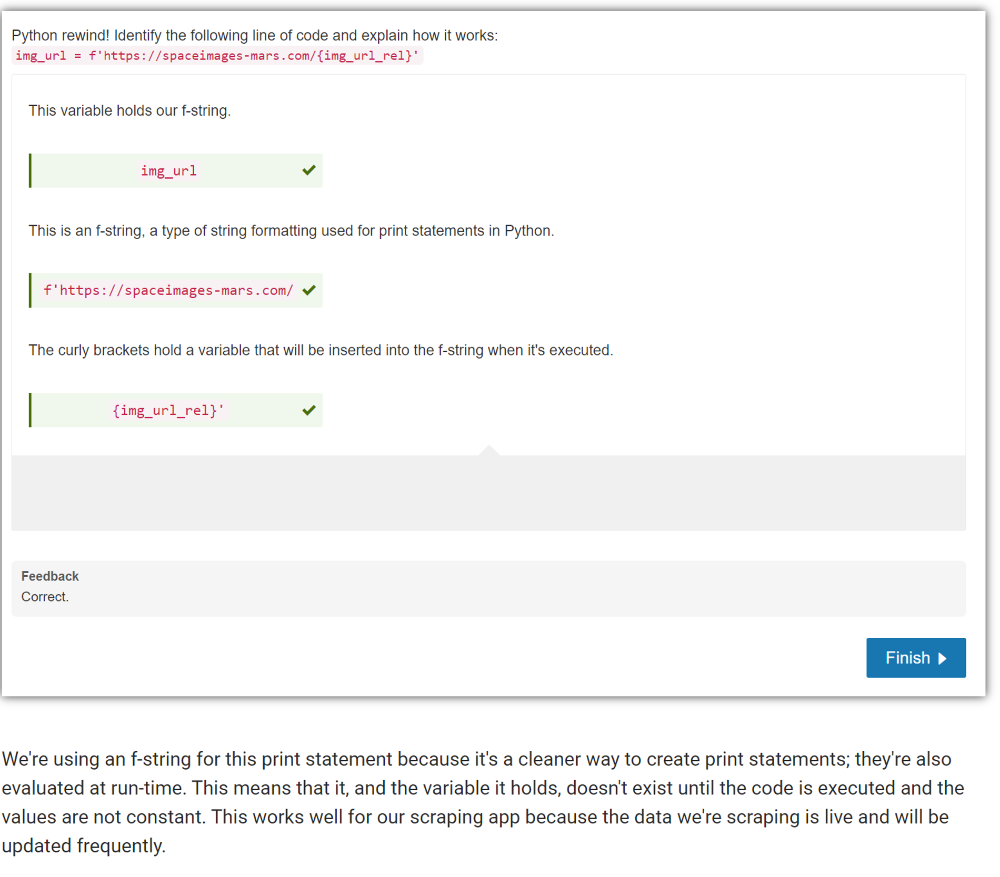

# Mod 10.3.5 Scrape the Mars Data: Mars Facts

# 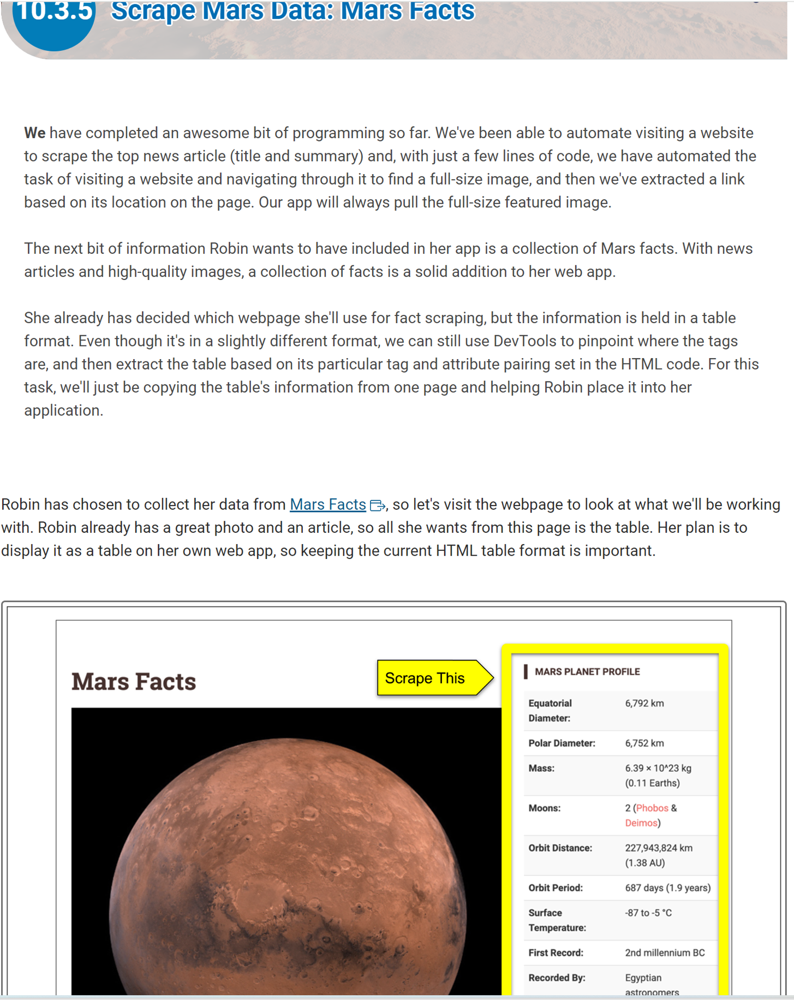

In [13]:
# Scrape entire Mars Facts table

df = pd.read_html('http://space-facts.com/mars/')[0]

df.columns=['Description', 'Mars']

df.set_index('Description', inplace=True)

df


# Now let's break it down.

#    df = pd.read_html('http://space-facts.com/mars/')[0]

#  With this line, we're creating a new DataFrame from the HTML table.
#  The Pandas function read_html() specifically searches for and returns a
#  tables it encounters, or the first item on the list. Then, it turns the table into a DataFrame.

#    df.columns=['Description', 'Mars'] Here, we assign columns to a new DataFrame for additional clarity.

#    df.set_index('Description', inplace=True) We're the Description column into the DataFrame index.
#      inplace=True means that the updated index will remain in place, without having to reassign the
#      DataFrame to a new variable. 

# This is exactly what we want to add to our web application. How do we add the DataFrame to a web application?

# How do we add the DataFrame to a web application? Pandas has a way to easily convert our DataFrame back into
# HTML-ready code using the to_html() function.

df.to_html()



'<table border="1" class="dataframe">\n  <thead>\n    <tr style="text-align: right;">\n      <th></th>\n      <th>Mars</th>\n    </tr>\n    <tr>\n      <th>Description</th>\n      <th></th>\n    </tr>\n  </thead>\n  <tbody>\n    <tr>\n      <th>Equatorial Diameter:</th>\n      <td>6,792 km</td>\n    </tr>\n    <tr>\n      <th>Polar Diameter:</th>\n      <td>6,752 km</td>\n    </tr>\n    <tr>\n      <th>Mass:</th>\n      <td>6.39 × 10^23 kg (0.11 Earths)</td>\n    </tr>\n    <tr>\n      <th>Moons:</th>\n      <td>2 (Phobos &amp; Deimos)</td>\n    </tr>\n    <tr>\n      <th>Orbit Distance:</th>\n      <td>227,943,824 km (1.38 AU)</td>\n    </tr>\n    <tr>\n      <th>Orbit Period:</th>\n      <td>687 days (1.9 years)</td>\n    </tr>\n    <tr>\n      <th>Surface Temperature:</th>\n      <td>-87 to -5 °C</td>\n    </tr>\n    <tr>\n      <th>First Record:</th>\n      <td>2nd millennium BC</td>\n    </tr>\n    <tr>\n      <th>Recorded By:</th>\n      <td>Egyptian astronomers</td>\n    </tr>\n

## The result is a slightly confusing-looking set of HTML code - it's a "table" element with
## a lot of nested elements. This means success!

In [14]:
# Now that we've gathered everything on Robin's list, we can end the automated browsing session. Without this code,
# the automated web browser will continue to listen for instructions. We only want to automated browser to remain 
# active while we're scraping data.

browser.quit()


# IMPORTANT

# Live sites are a great resource for fresh datga, but the layout of the site may be updated or otherwise changed.
# When this happens, there's a good chance your scraping code will break and need to be reviewed and updated to 
# be used again. 

# For example, an image may suddenly become embedded with an inaccessible block of code because the
# developers swithch to a new JavaScript library. It's not uncommon to revise code to find workarounds or 
# even look for a different, scraping-friendly site all together.

# Export to Python

In [15]:
# Jupyter Notebook is the perfect tool for builing a scaping script, but we can't automate the scraping
# using Jupyter Notebook. To fully automate it, it will need to be converted into a .py file. 

# the next step in making this an automated process it to download the current code into a Python file.
# It won't transiiton perectly, we'll need to clean it up a bit, but it is an easier task than copying
# each cell and pasting it over in the correct order. 

# Jupyter Notebook can be downloaded into DIFFERENT FORMATS.

#  1. Navigate to the "File" tab in Jupyter Notebook menu.
#  2. Go to "Download as"
#  3. Python (.py)
#  4. If you get a warning about downloading this type of file, click "Keep" to continue the download.
#  5. Navigate to your "Downloads" folder and open the new file. A brief look at the first lines of code
#     shows us that the code wasn't the only thing to be ported over. The number of time each cell has been
#     run is also there, for example.
#  6. Clean up the code by removing unnecessary blank spaces and comments.

# Mod 10.4.1 Store the Data



## 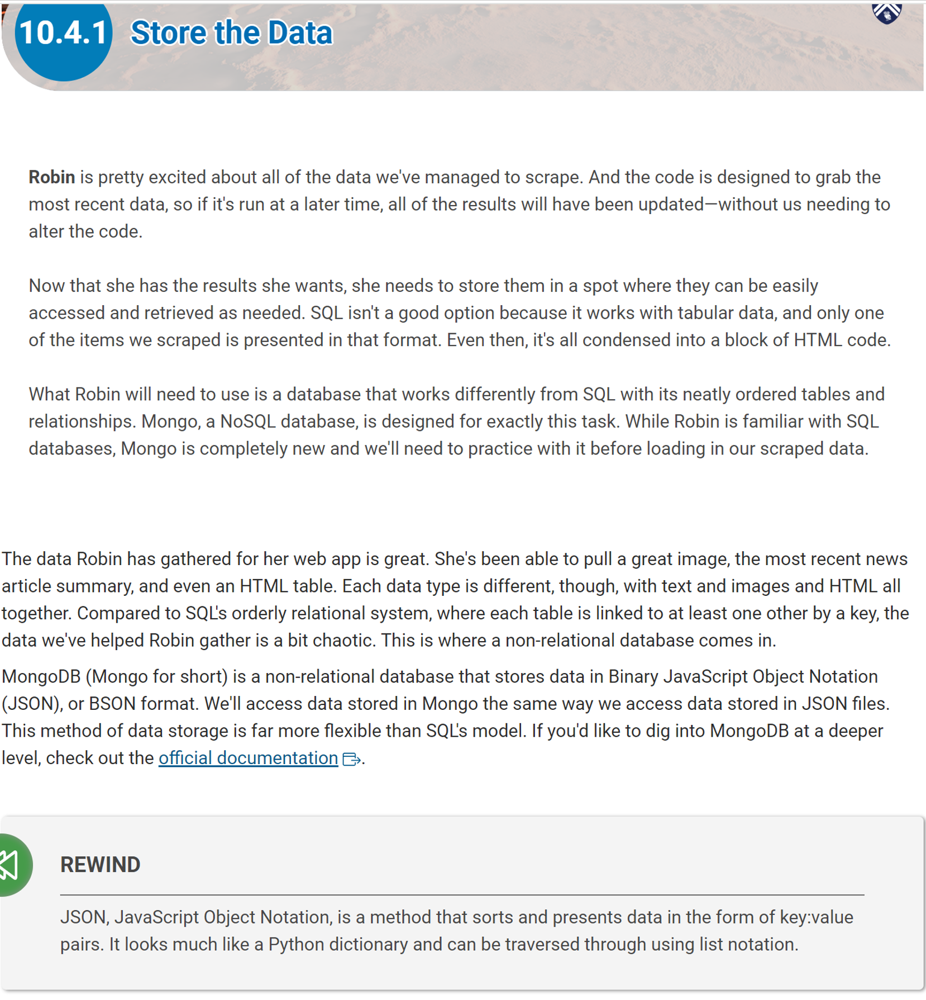

## 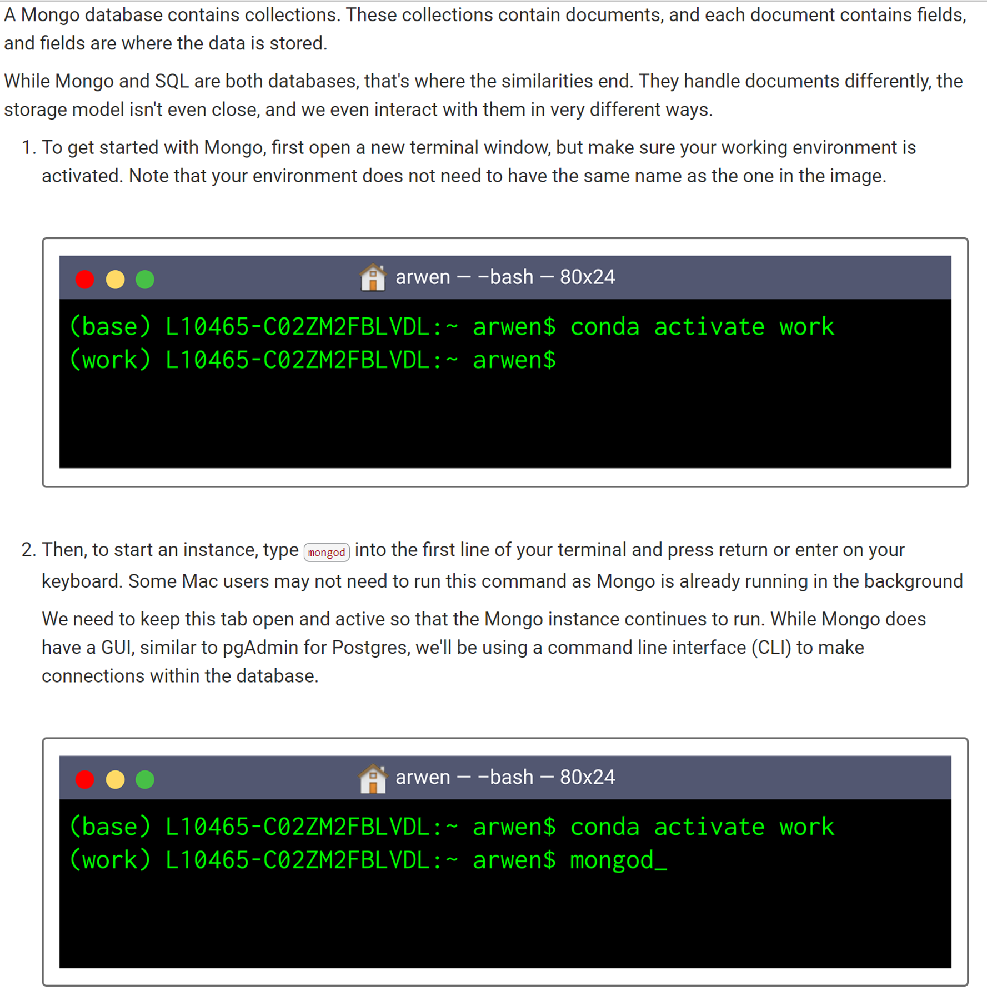

# 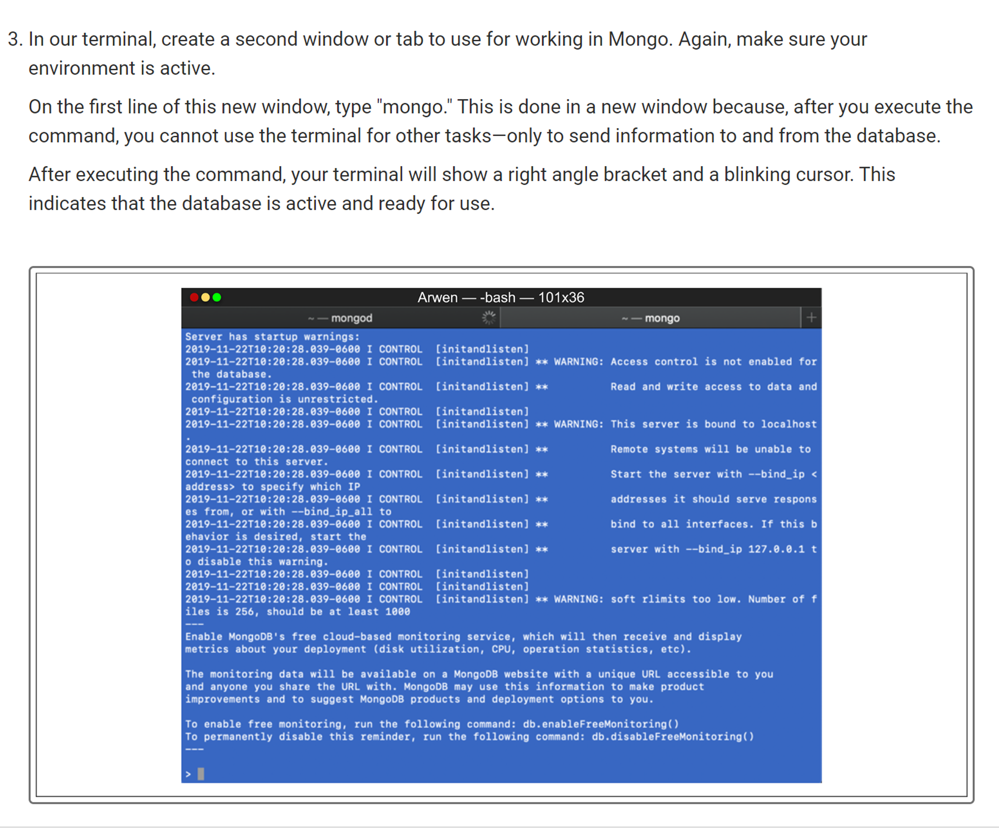

# Mod 10.5.1 Use Flask to Create a Web App

# 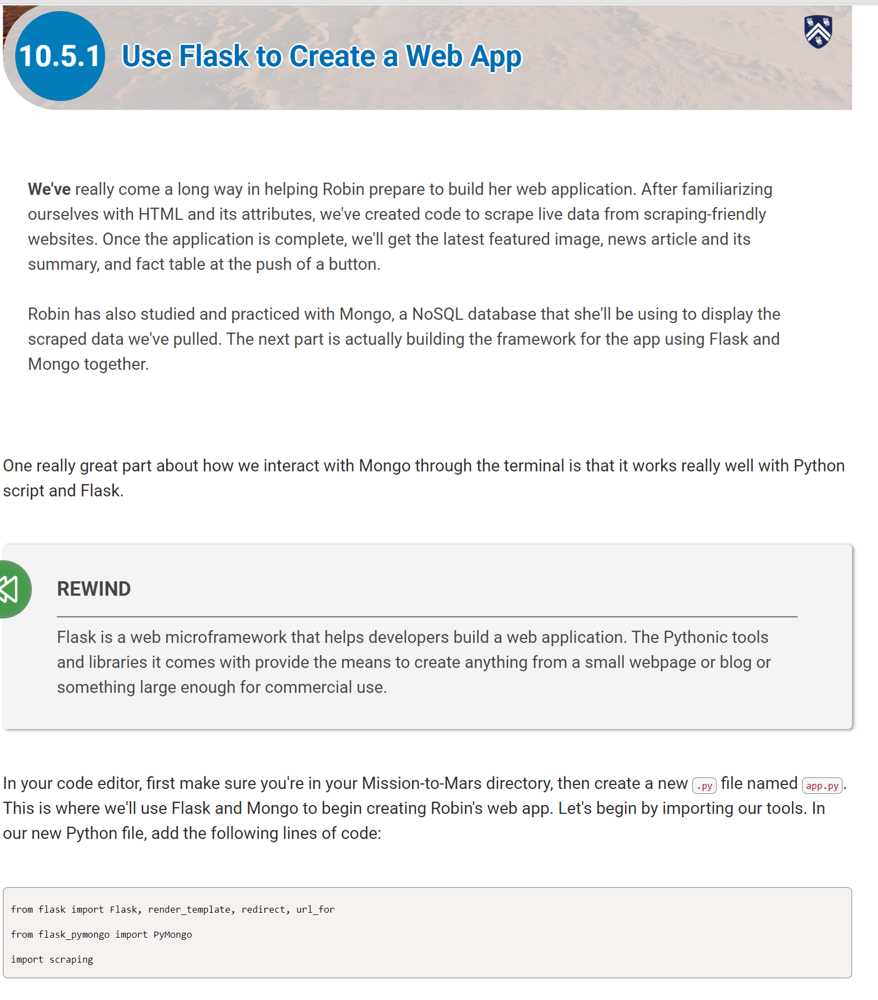

# 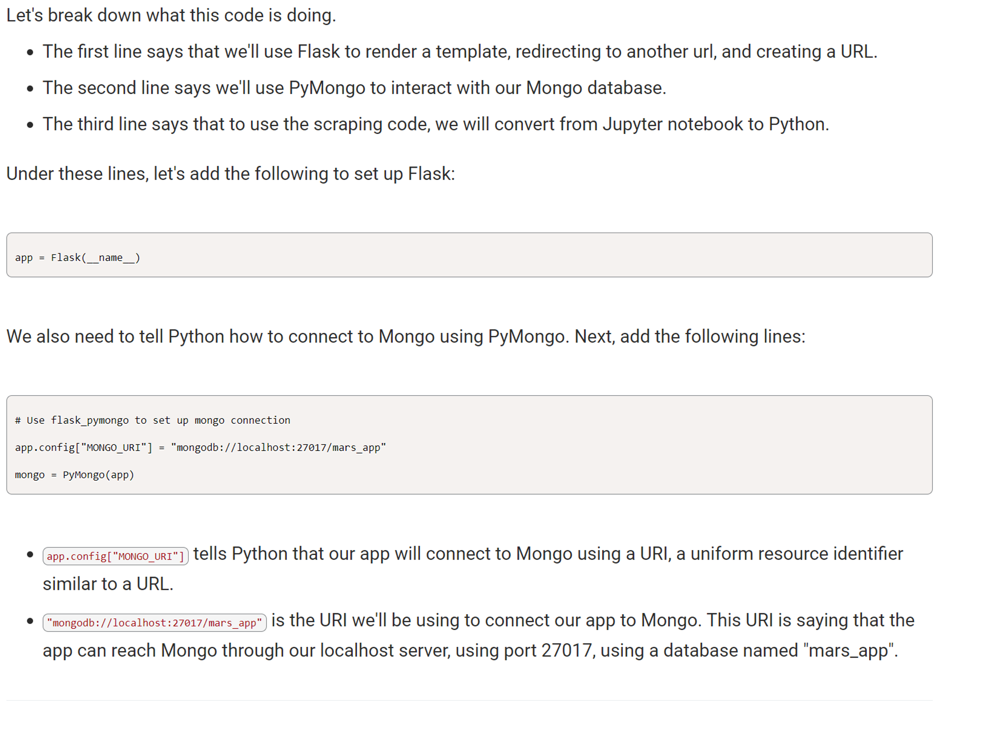

# Set up App Routes

# ====================================================

# 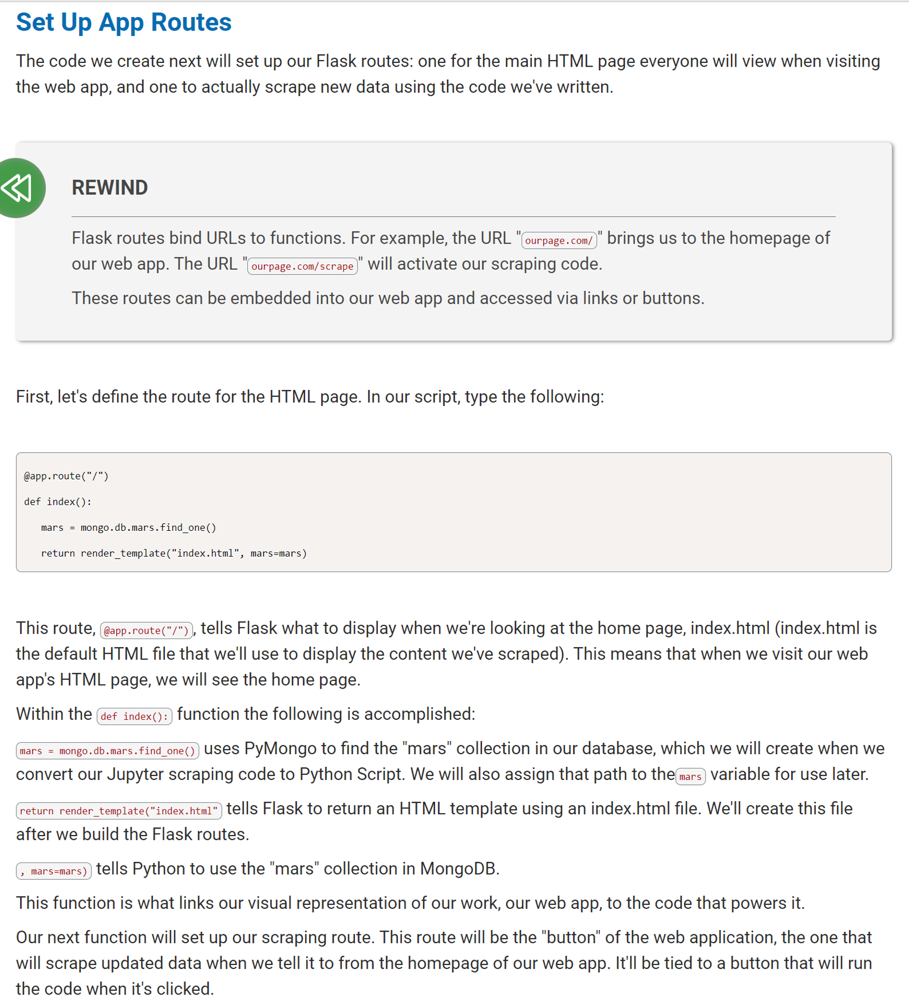

# 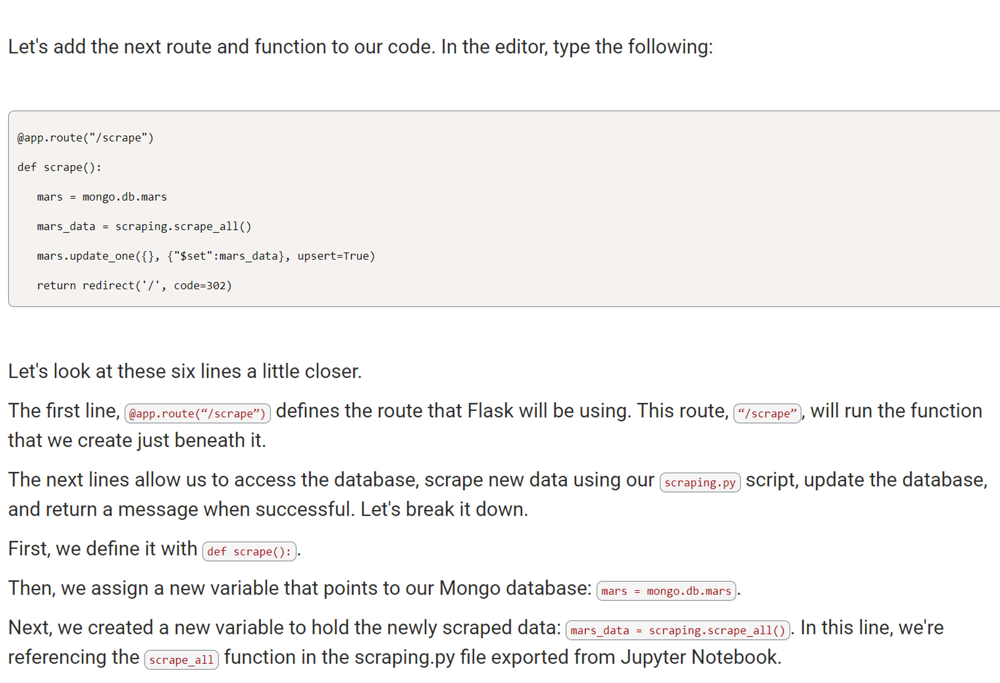

# Mod 10.5.2 Update the Code
# ==========================================
# ==========================================

## There are two things we want to update in our code:
##   1. Refactor it to include functions
##   2. Add some error handling

# 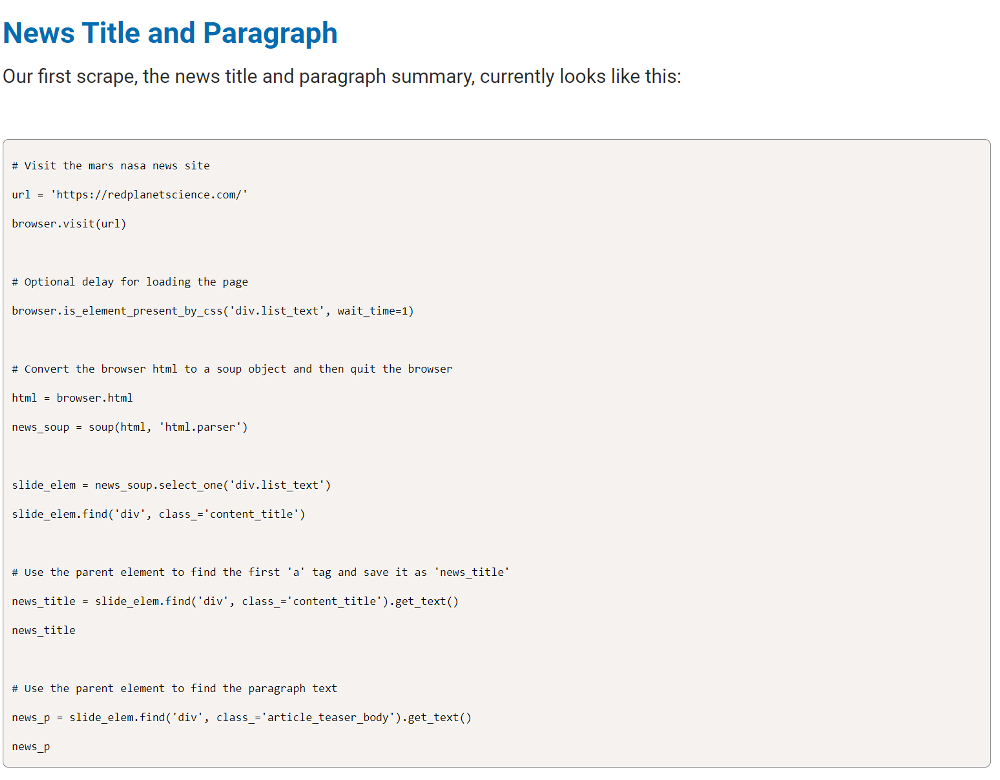

# 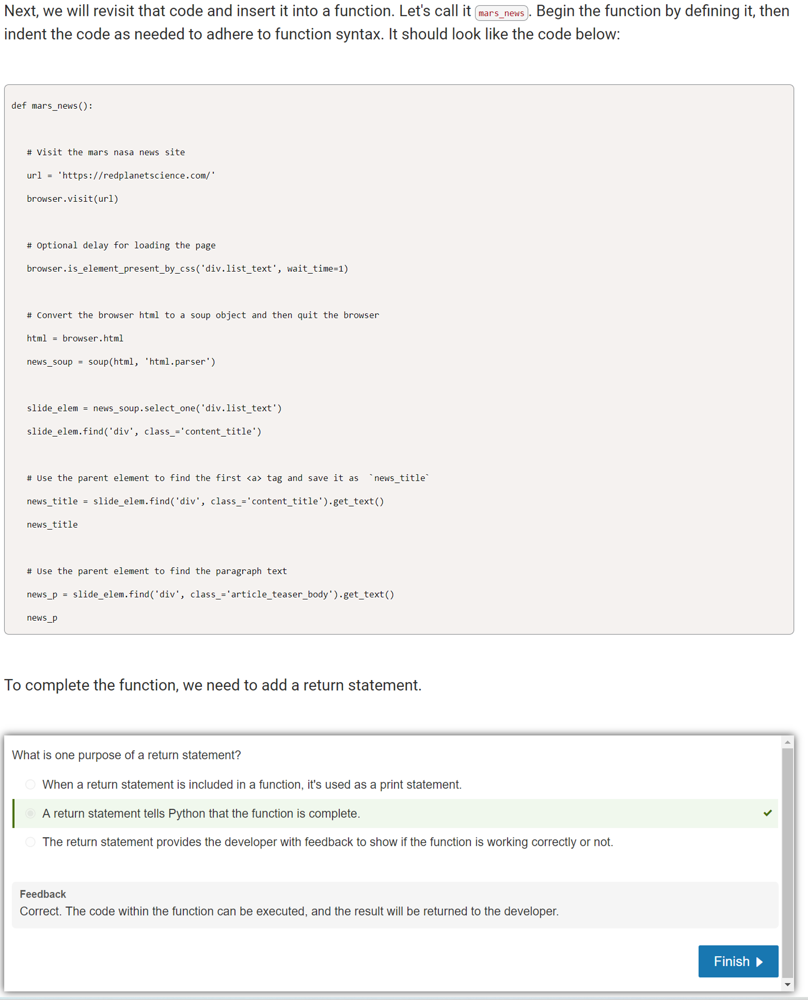

# 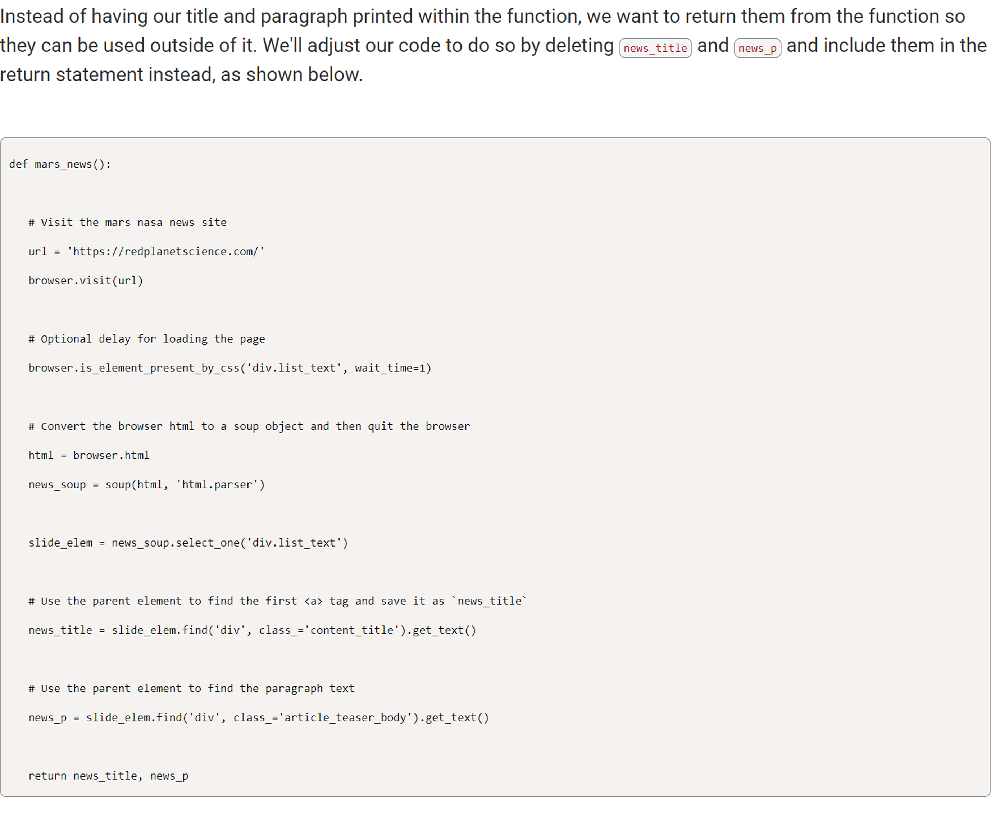

# 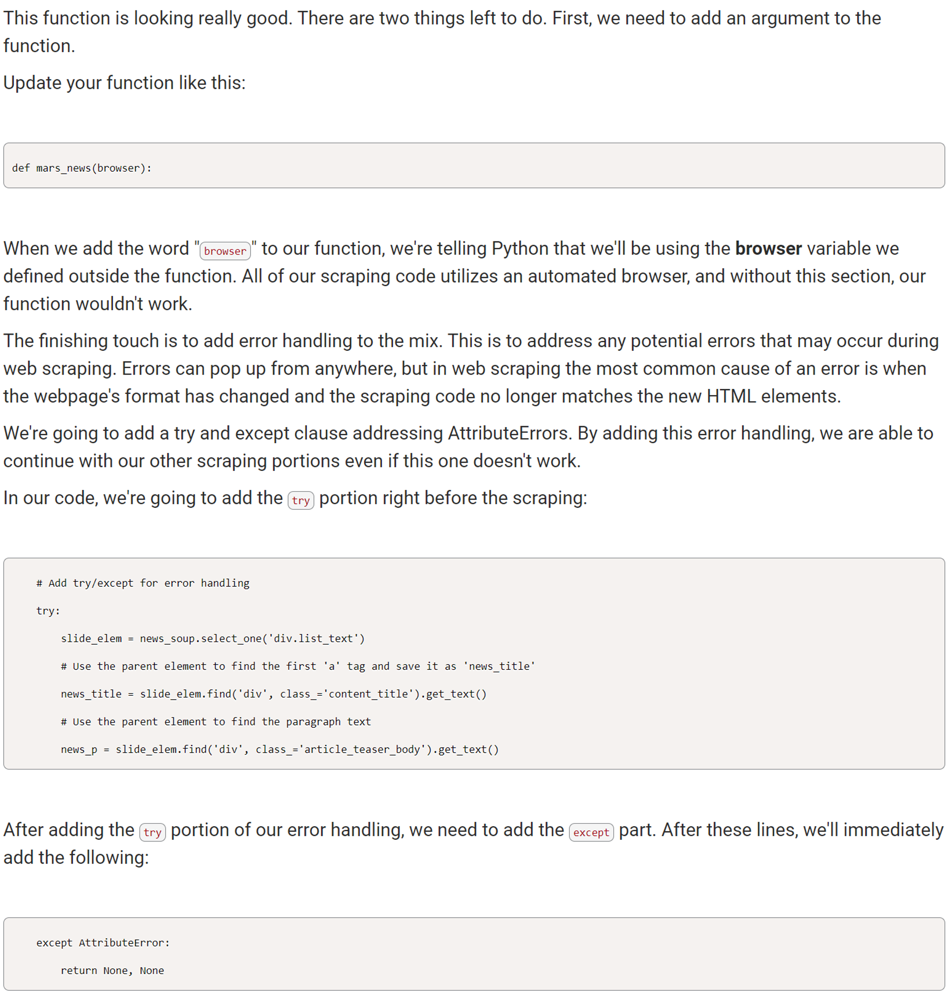

# 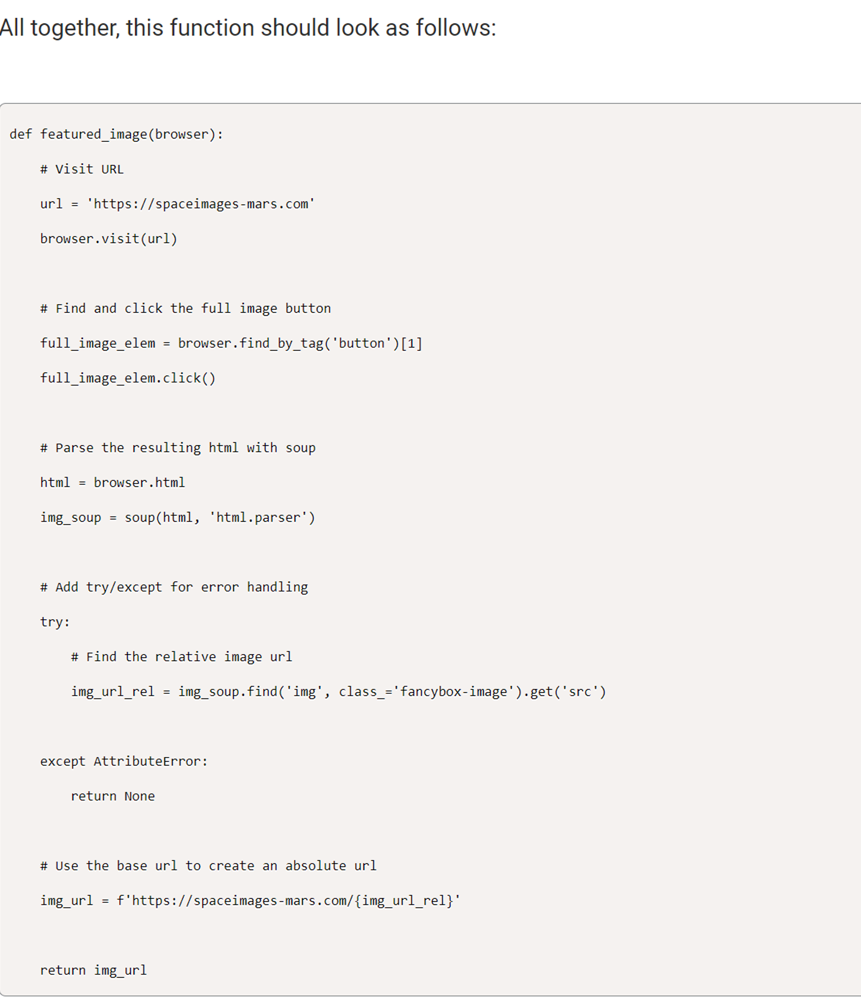

# 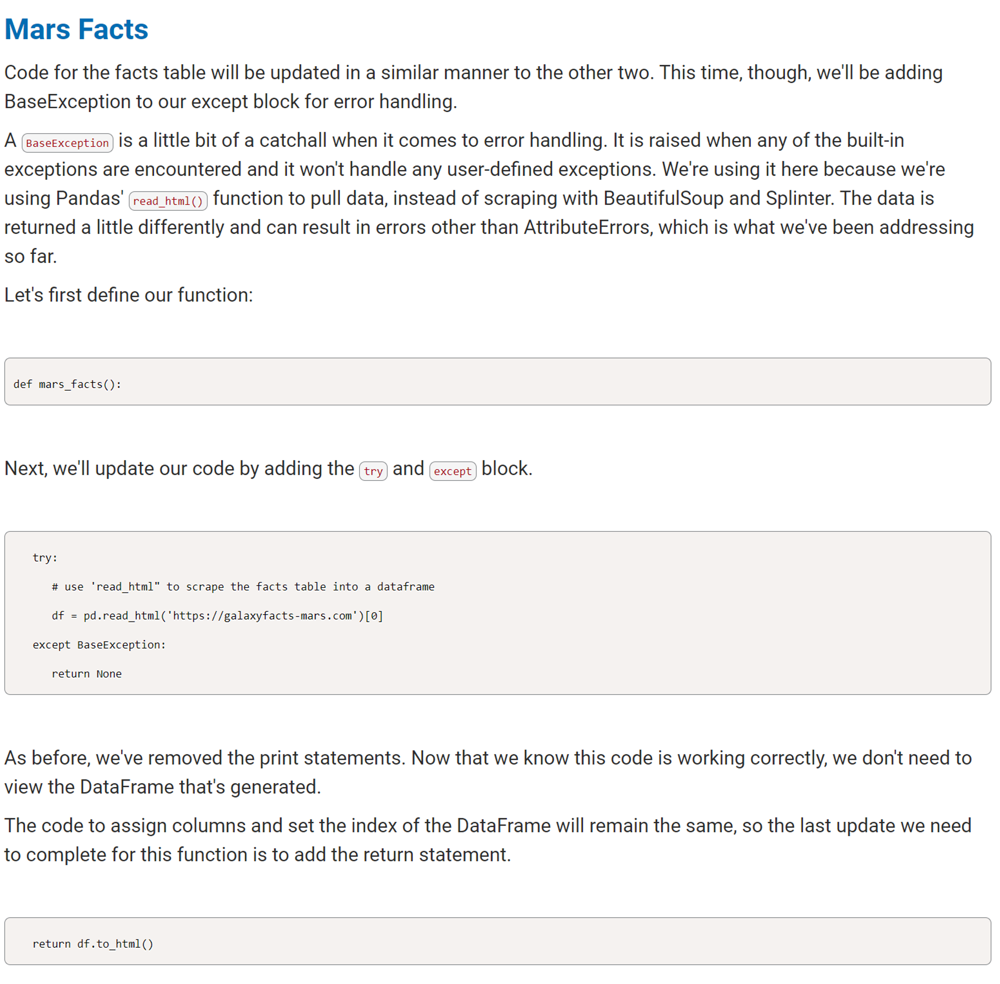

# 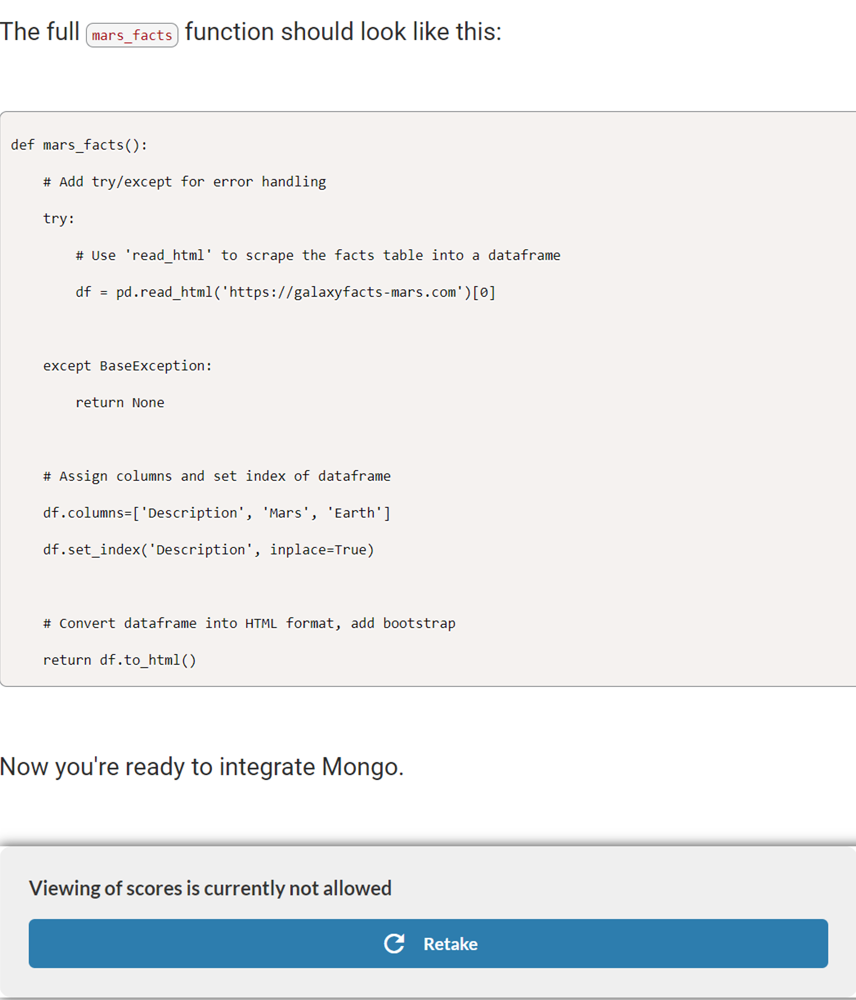

# 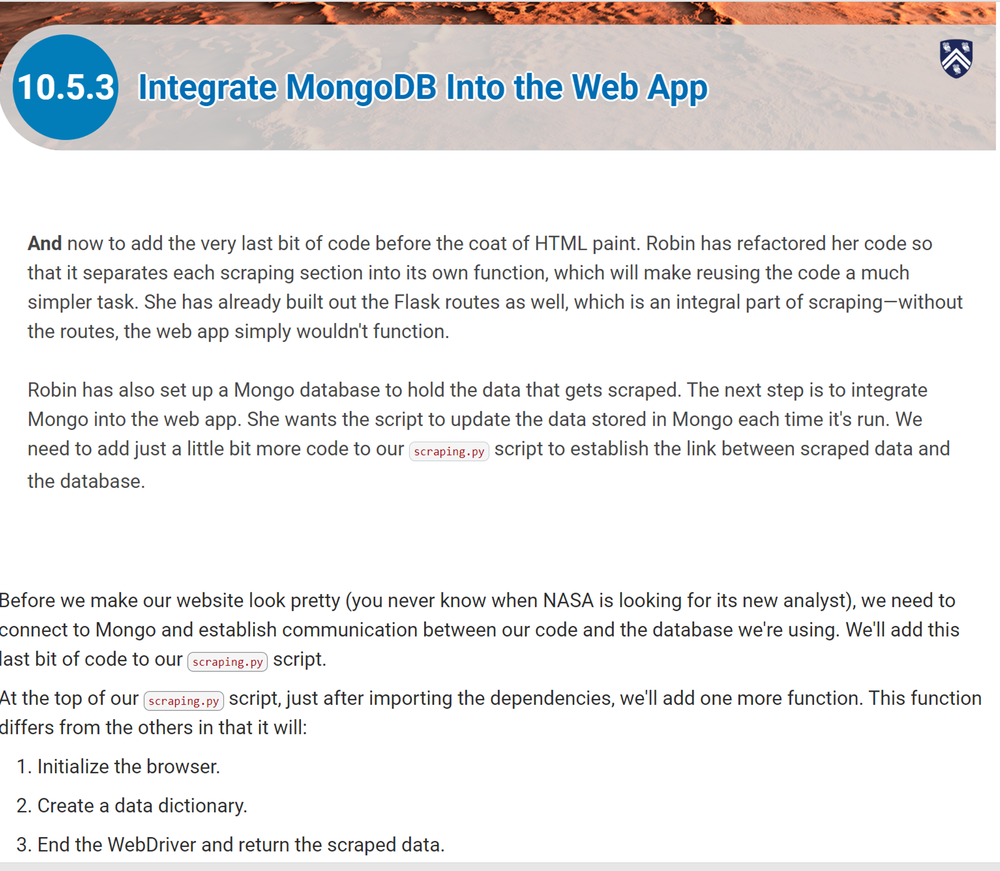

# 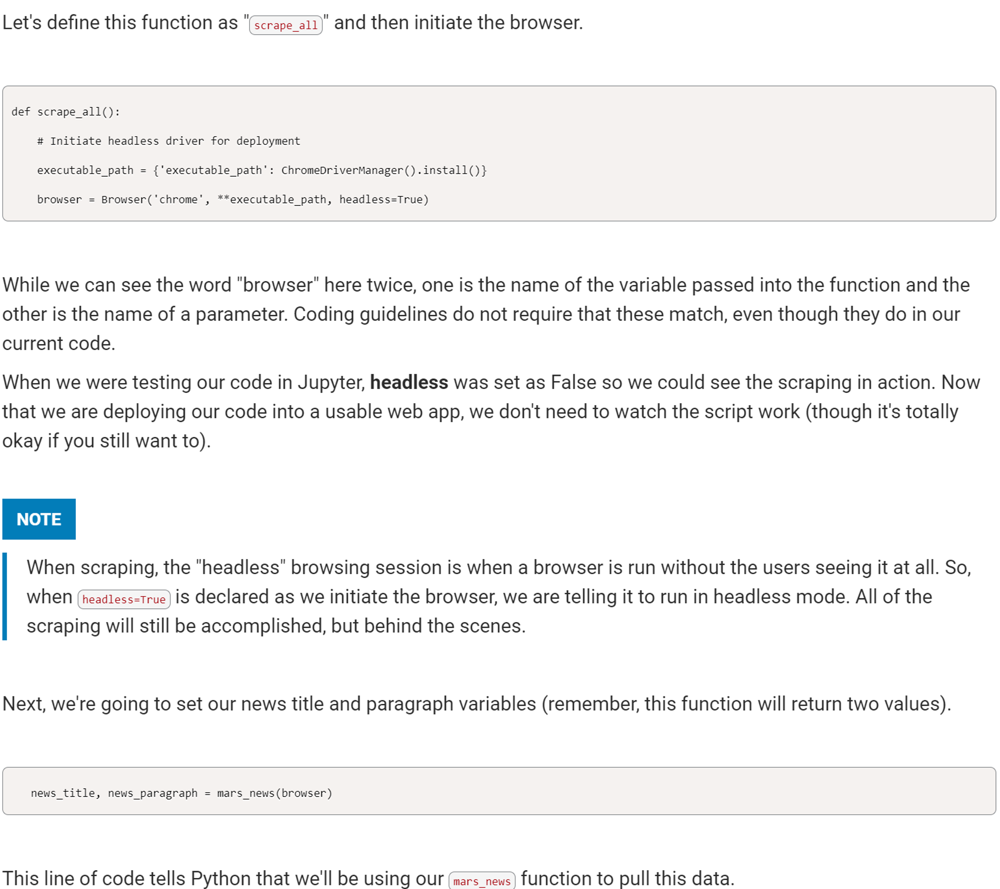

# 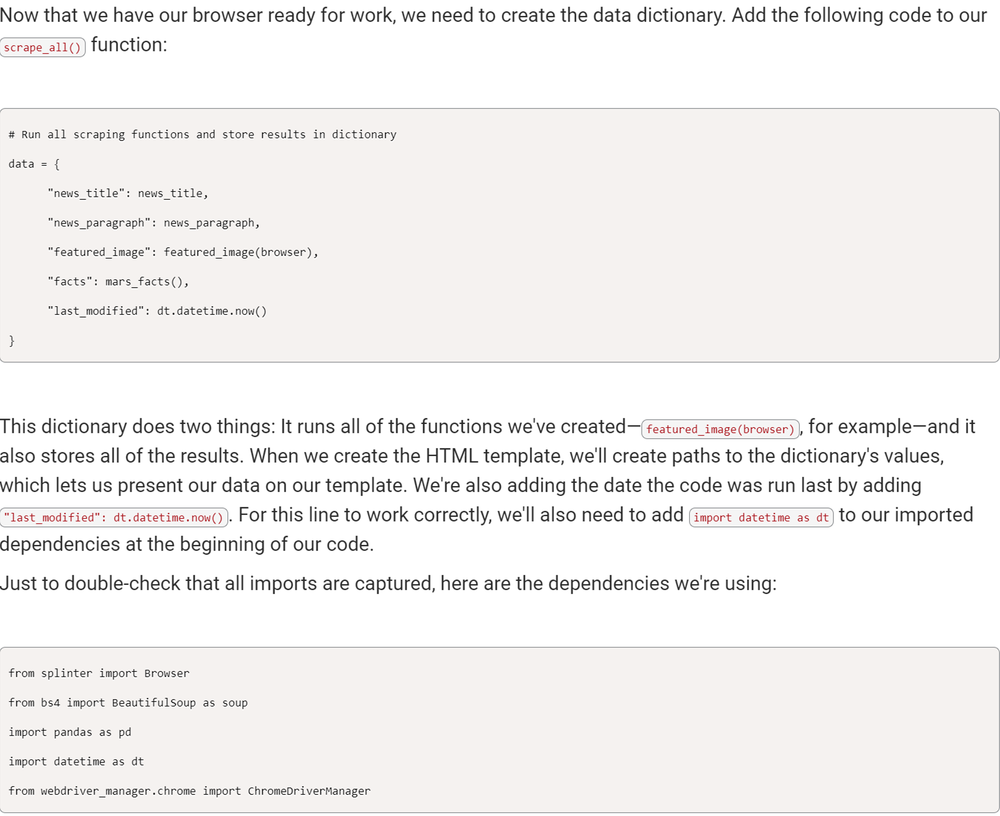

# 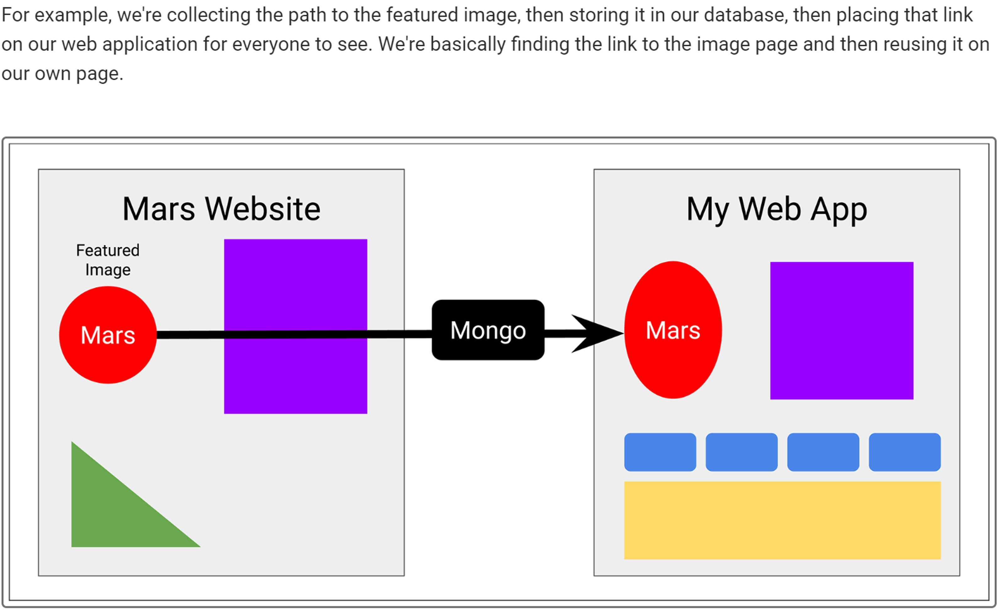

# 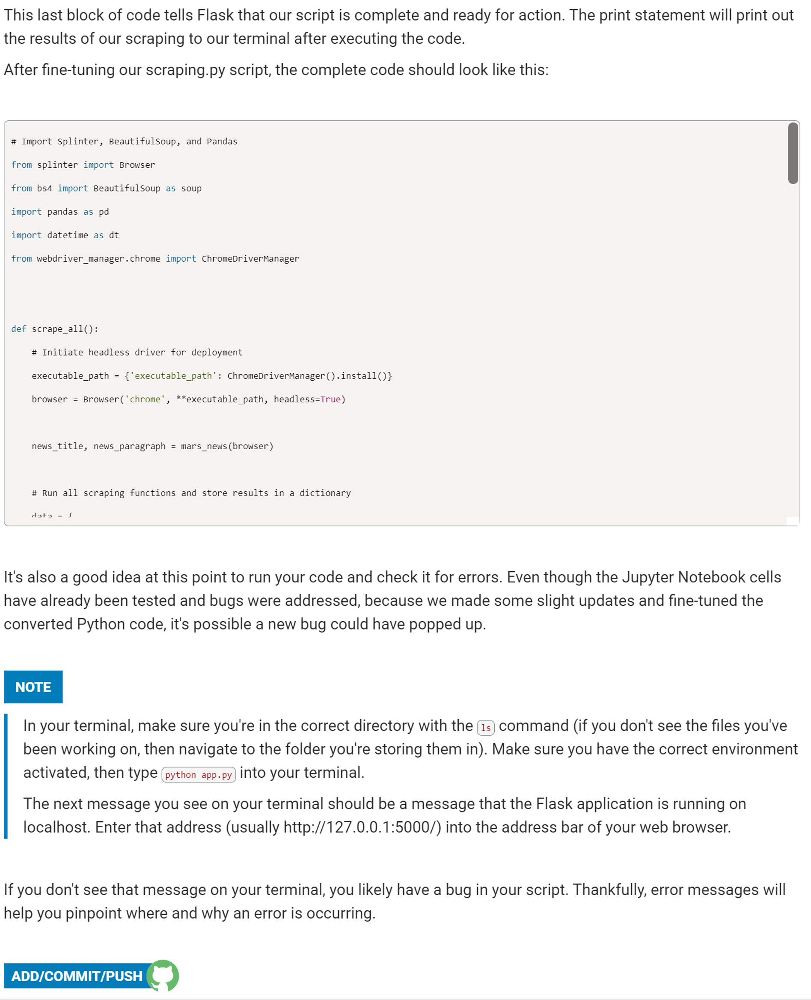